# Retrieving en face images from the dataset

In [2]:
# !pip3.6 install matplotlib

In [3]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "3"

In [4]:
from keras.backend.tensorflow_backend import set_session
import tensorflow as tf
config = tf.ConfigProto()
config.gpu_options.allow_growth = True

set_session(tf.Session(config=config))

Using TensorFlow backend.


In [5]:
import sys
print(sys.path)
sys.path.append('gradcam')
print(sys.path)

['', '/usr/lib/python36.zip', '/usr/lib/python3.6', '/usr/lib/python3.6/lib-dynload', '/usr/local/lib/python3.6/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.6/dist-packages/IPython/extensions', '/root/.ipython']
['', '/usr/lib/python36.zip', '/usr/lib/python3.6', '/usr/lib/python3.6/lib-dynload', '/usr/local/lib/python3.6/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.6/dist-packages/IPython/extensions', '/root/.ipython', 'gradcam']


### Loading data

In [6]:
import numpy as np
from matplotlib import pyplot as plt

fig = plt.figure(figsize=(10, 10))   

In [7]:
datasetDir = "/home/workspace/itautkute/emotionaldan/data/"
trainSet = np.load(datasetDir + "AffectnetTrain_7.npz")
danPath = '/home/workspace/itautkute/emotionaldan/Model2/Model2'
Xtrain = trainSet['Image']
Ytrain = trainSet['Landmark']
Ytrain_em = trainSet['Emotion']

initLandmarks = trainSet['Landmark'][0].reshape((1,136))

In [8]:
len(Xtrain)

283849

Landmarks 72-96 are responsible for eye location. 

* Left eye corner: landmark number 72, 73
* Right eye corner: landmark number 90, 91

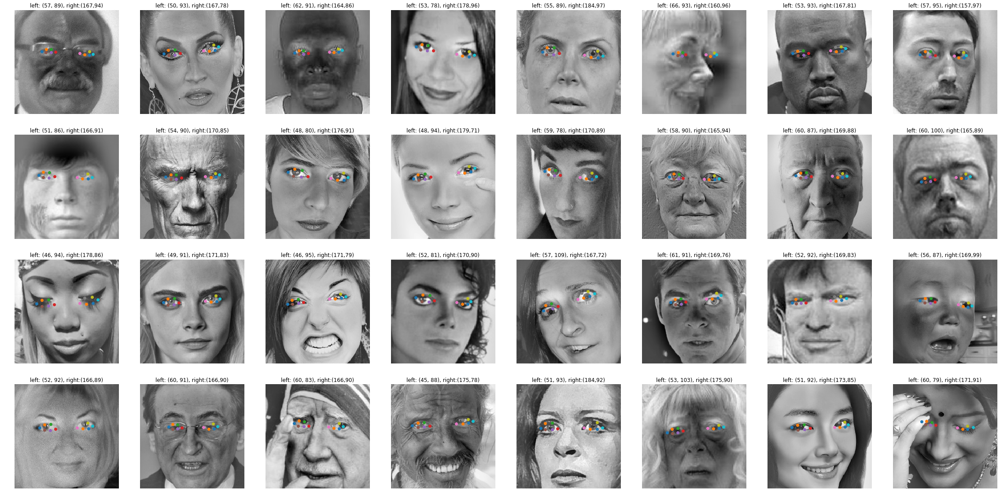

In [9]:
N, M = 8, 4

f, axarr = plt.subplots(M,N, figsize=(40,20))

for i in range(M):
    for j in range(N):
        idx = j*M+i
        img = np.reshape(Xtrain[idx], (224, 224))
        lndm = Ytrain[idx]
        lndm_eyes = lndm[72:96]
        x_s = lndm_eyes[0:][::2]
        y_s = lndm_eyes[1:][::2]
        batch_img = [Xtrain[idx]]
        batch_label = [Ytrain_em[idx]]
        axarr[i,j].imshow(img, cmap='gray')
        for x, y in zip(x_s, y_s):
            axarr[i,j].scatter([x],[y])
        axarr[i,j].axis('off')
        axarr[i,j].set_title("left: ({}, {}), right:({},{})".format(int(lndm[72]),int(lndm[73]),int(lndm[90]),int(lndm[91])))
        

### Retrieve "en face" images

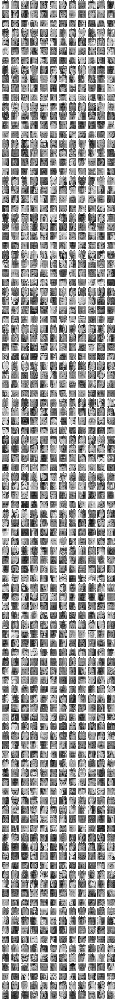

In [10]:
N, M = 12, 108

LEFT_EYE_X = range(40,55)
LEFT_EYE_Y = range(75,93)
RIGHT_EYE_X = range(165,175)
RIGHT_EYE_Y = range(75,93) 

f, axarr = plt.subplots(M,N, figsize=(40,360))
img_id = 0

en_face_images = []

for i in range(M):
    for j in range(N):
        for idx in range(img_id, 10000):
            img = np.reshape(Xtrain[idx], (224, 224))
            lndm = Ytrain[idx]
            if (int(lndm[72]) in LEFT_EYE_X) and (int(lndm[73]) in LEFT_EYE_Y) and int(lndm[90]) in RIGHT_EYE_X and int(lndm[91]) in RIGHT_EYE_Y:
#                 print(i, j, idx)
                batch_img = [Xtrain[idx]]
                batch_label = [Ytrain_em[idx]]
                axarr[i,j].imshow(img, cmap='gray')
                axarr[i,j].axis('off')
                axarr[i,j].set_title("({}, {}), ({},{})".format(int(lndm[72]),int(lndm[73]),int(lndm[90]),int(lndm[91])))
                img_id = idx + 1
                en_face_images.append([Xtrain[idx], Ytrain[idx], Ytrain_em[idx]])
                break
        

In [12]:
len(en_face_images)

1334

In [13]:
np.save('data/en_face', en_face_images)

In [ ]:
M, N = 5, 5

f, axarr = plt.subplots(M,N, figsize=(40,40))

batch_img = []
batch_label = []

for i in range(M):
    for j in range(N):
        idx = j*M+i+100
#         img = np.reshape(Xtrain[idx], (224, 224))
        batch_img = [Xtrain[idx]]
        batch_label = [Ytrain_em[idx]]
        cam_image = get_grad_cam(batch_img, batch_label, danPath,  emodan, img_mask=0.5)
        axarr[i,j].imshow(cam_image)
        axarr[i,j].axis('off')
#         